In [31]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

In [32]:
"""
TÚNEL DE VIENTO 2D - Método de Navier-Stokes Simplificado
Más simple y directo que LBM - Ideal para proyecto de curso

Este código resuelve las ecuaciones de Navier-Stokes usando:
- Método de diferencias finitas
- Algoritmo de proyección (Chorin)
- Esquema explícito en tiempo
"""

import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# PARÁMETROS DE LA SIMULACIÓN

# Dominio
NX, NY = 200, 100        # Puntos de la malla
LX, LY = 4.0, 2.0        # Tamaño físico del dominio
DX, DY = LX/NX, LY/NY    # Espaciado de la malla

# Propiedades del fluido
RHO = 1.0                # Densidad
NU = 0.01                # Viscosidad cinemática (nu = μ/ρ)
U_INLET = 1.0            # Velocidad de entrada

# Tiempo
DT = 0.001               # Paso de tiempo (importante: debe ser pequeño)
TIMESTEPS = 3000         # Número de pasos
SAVE_INTERVAL = 30       # Guardar cada N pasos

# Geometría del obstáculo
GEOMETRIA = 'circulo'    # 'circulo', 'cuadrado', 'triangulo'

# Crear carpeta outputs
OUTPUT_DIR = 'outputs'
os.makedirs(OUTPUT_DIR, exist_ok=True)

# CÁLCULO DEL NÚMERO DE REYNOLDS

# Tamaño característico del obstáculo
D = LY / 5  # Diámetro/lado del obstáculo
REYNOLDS = U_INLET * D / NU

print("SIMULACIÓN DE TÚNEL DE VIENTO - NAVIER-STOKES")
print(f"Dominio: {NX} × {NY} puntos")
print(f"Tamaño físico: {LX} × {LY} metros")
print(f"Viscosidad: ν = {NU} m²/s")
print(f"Velocidad entrada: U = {U_INLET} m/s")
print(f"Número de Reynolds: Re = {REYNOLDS:.1f}")
print(f"Paso de tiempo: Δt = {DT}")
print(f"Geometría: {GEOMETRIA.upper()}")
print("="*70 + "\n")

# INICIALIZACIÓN

# Campos de velocidad (en nodos de la malla)
u = np.zeros((NY, NX))  # Velocidad horizontal (u)
v = np.zeros((NY, NX))  # Velocidad vertical (v)
p = np.zeros((NY, NX))  # Presión

# Campos temporales para el algoritmo
u_temp = np.zeros((NY, NX))
v_temp = np.zeros((NY, NX))

# CREAR OBSTÁCULO

def crear_obstaculo(tipo, nx, ny):
    """Crea máscara del obstáculo"""
    obstacle = np.zeros((ny, nx), dtype=bool)

    # Centro del obstáculo (1/3 desde la entrada)
    cx = nx // 3
    cy = ny // 2

    if tipo == 'circulo':
        radius = ny // 8
        print(f"Obstáculo: CÍRCULO (radio={radius} celdas)")
        for i in range(ny):
            for j in range(nx):
                if (j - cx)**2 + (i - cy)**2 <= radius**2:
                    obstacle[i, j] = True

    elif tipo == 'cuadrado':
        side = ny // 5
        print(f"Obstáculo: CUADRADO ({side}×{side} celdas)")
        y_start, y_end = cy - side//2, cy + side//2
        x_start, x_end = cx - side//2, cx + side//2
        obstacle[y_start:y_end, x_start:x_end] = True

    elif tipo == 'triangulo':
        height = ny // 4
        base = ny // 4
        print(f"Obstáculo: TRIÁNGULO (altura={height} celdas, base={base})")
        for i in range(cy - height//2, cy + height//2):
            # Calcular ancho desde 0 (punta izquierda) hasta base completa
            dist_from_top = i - (cy - height//2)
            width_at_row = int(base * dist_from_top / height)
            obstacle[i, cx : cx + width_at_row + 1] = True

    return obstacle, (cx, cy)

obstacle, (obs_x, obs_y) = crear_obstaculo(GEOMETRIA, NX, NY)
print(f"Celdas del obstáculo: {np.sum(obstacle)}")
print()

# CONDICIONES DE FRONTERA

def aplicar_condiciones_frontera(u, v, p, obstacle):
    """
    Aplica condiciones de frontera:
    - Entrada (izquierda): velocidad constante
    - Salida (derecha): gradiente cero
    - Paredes (arriba/abajo): sin deslizamiento
    - Obstáculo: sin deslizamiento
    """

    # ENTRADA (izquierda) - velocidad constante
    u[:, 0] = U_INLET
    v[:, 0] = 0.0

    # SALIDA (derecha) - gradiente cero (extrapolación)
    u[:, -1] = u[:, -2]
    v[:, -1] = v[:, -2]
    p[:, -1] = 0.0  # Presión de referencia

    # PAREDES superior e inferior - sin deslizamiento
    u[0, :] = 0.0
    u[-1, :] = 0.0
    v[0, :] = 0.0
    v[-1, :] = 0.0

    # OBSTÁCULO - sin deslizamiento (velocidad = 0)
    u[obstacle] = 0.0
    v[obstacle] = 0.0

    return u, v, p

# ECUACIONES DE NAVIER-STOKES

def calcular_termino_convectivo_u(u, v, dx, dy):
    """
    Calcula el término convectivo para u: u·∇u
    """
    # Derivadas espaciales (diferencias centradas)
    du_dx = np.zeros_like(u)
    du_dy = np.zeros_like(u)

    du_dx[1:-1, 1:-1] = (u[1:-1, 2:] - u[1:-1, :-2]) / (2 * dx)
    du_dy[1:-1, 1:-1] = (u[2:, 1:-1] - u[:-2, 1:-1]) / (2 * dy)

    # u·∇u = u * ∂u/∂x + v * ∂u/∂y
    conv = u * du_dx + v * du_dy

    return conv

def calcular_termino_convectivo_v(u, v, dx, dy):
    """
    Calcula el término convectivo para v: u·∇v
    """
    dv_dx = np.zeros_like(v)
    dv_dy = np.zeros_like(v)

    dv_dx[1:-1, 1:-1] = (v[1:-1, 2:] - v[1:-1, :-2]) / (2 * dx)
    dv_dy[1:-1, 1:-1] = (v[2:, 1:-1] - v[:-2, 1:-1]) / (2 * dy)

    conv = u * dv_dx + v * dv_dy

    return conv

def calcular_termino_difusivo(campo, dx, dy):
    """
    Calcula el término difusivo: ν·∇²campo
    Usando Laplaciano con diferencias finitas
    """
    laplaciano = np.zeros_like(campo)

    laplaciano[1:-1, 1:-1] = (
        (campo[1:-1, 2:] - 2*campo[1:-1, 1:-1] + campo[1:-1, :-2]) / dx**2 +
        (campo[2:, 1:-1] - 2*campo[1:-1, 1:-1] + campo[:-2, 1:-1]) / dy**2
    )

    return NU * laplaciano

def resolver_presion(u_temp, v_temp, p, dx, dy, dt, max_iter=50):
    """
    Resuelve la ecuación de Poisson para la presión
    ∇²p = ρ/Δt · ∇·u*

    Usando método iterativo de Jacobi
    """
    # Calcular divergencia de la velocidad temporal
    div = np.zeros_like(p)
    div[1:-1, 1:-1] = (
        (u_temp[1:-1, 2:] - u_temp[1:-1, :-2]) / (2 * dx) +
        (v_temp[2:, 1:-1] - v_temp[:-2, 1:-1]) / (2 * dy)
    )

    # Iteraciones de Jacobi
    for _ in range(max_iter):
        p_new = p.copy()

        p_new[1:-1, 1:-1] = (
            (p[1:-1, 2:] + p[1:-1, :-2]) * dy**2 +
            (p[2:, 1:-1] + p[:-2, 1:-1]) * dx**2 -
            RHO * dx**2 * dy**2 / dt * div[1:-1, 1:-1]
        ) / (2 * (dx**2 + dy**2))

        # Condiciones de frontera para presión
        p_new[:, 0] = p_new[:, 1]      # Entrada
        p_new[:, -1] = 0               # Salida (referencia)
        p_new[0, :] = p_new[1, :]      # Pared superior
        p_new[-1, :] = p_new[-2, :]    # Pared inferior

        p = p_new.copy()

    return p

# ALGORITMO DE PROYECCIÓN (MÉTODO DE CHORIN)

def paso_navier_stokes(u, v, p, obstacle, dx, dy, dt):
    """
    Realiza un paso de tiempo completo usando el algoritmo de proyección:

    1. Calcular velocidad intermedia (sin presión)
    2. Resolver presión
    3. Corregir velocidad (proyección)
    """

    # PASO 1: Velocidad intermedia (sin presión)
    # ∂u/∂t = -u·∇u + ν·∇²u

    conv_u = calcular_termino_convectivo_u(u, v, dx, dy)
    diff_u = calcular_termino_difusivo(u, dx, dy)

    conv_v = calcular_termino_convectivo_v(u, v, dx, dy)
    diff_v = calcular_termino_difusivo(v, dx, dy)

    # Velocidad temporal (sin corrección de presión)
    u_temp = u + dt * (-conv_u + diff_u)
    v_temp = v + dt * (-conv_v + diff_v)

    # Aplicar condiciones de frontera
    u_temp, v_temp, _ = aplicar_condiciones_frontera(u_temp, v_temp, p, obstacle)

    # PASO 2: Resolver presión
    p = resolver_presion(u_temp, v_temp, p, dx, dy, dt)

    # PASO 3: Corregir velocidad (proyección)
    # u^(n+1) = u* - Δt/ρ · ∇p

    # Gradiente de presión
    dp_dx = np.zeros_like(p)
    dp_dy = np.zeros_like(p)

    dp_dx[1:-1, 1:-1] = (p[1:-1, 2:] - p[1:-1, :-2]) / (2 * dx)
    dp_dy[1:-1, 1:-1] = (p[2:, 1:-1] - p[:-2, 1:-1]) / (2 * dy)

    # Corregir velocidades
    u_new = u_temp - dt / RHO * dp_dx
    v_new = v_temp - dt / RHO * dp_dy

    # Aplicar condiciones de frontera finales
    u_new, v_new, p = aplicar_condiciones_frontera(u_new, v_new, p, obstacle)

    return u_new, v_new, p

# SIMULACIÓN PRINCIPAL

print("Iniciando simulación de Navier-Stokes...\n")

frames = []
fig = plt.figure(figsize=(14, 6))

# Grids para visualización
x = np.linspace(0, LX, NX)
y = np.linspace(0, LY, NY)
X, Y = np.meshgrid(x, y)

for step in range(TIMESTEPS):

    # Paso de Navier-Stokes
    u, v, p = paso_navier_stokes(u, v, p, obstacle, DX, DY, DT)

    # Guardar frames para animación
    if step % SAVE_INTERVAL == 0:
        plt.clf()
        ax = plt.gca()

        # Calcular velocidad total
        speed = np.sqrt(u**2 + v**2)

        # Mapa de velocidad
        im = ax.contourf(X, Y, speed, levels=20, cmap='Blues', alpha=0.7)

        # Líneas de corriente
        seed_points = np.array([[0.2, y_val] for y_val in np.linspace(0.3*LY, 0.7*LY, 12)])
        ax.streamplot(X, Y, u, v, color='darkblue', linewidth=1.5,
                     density=1.5, arrowsize=1.2, start_points=seed_points)

        # Obstáculo
        obstacle_plot = np.ma.masked_where(~obstacle, np.ones_like(obstacle))
        ax.contourf(X, Y, obstacle_plot, levels=[0.5, 1.5], colors=['red'], alpha=0.8)

        # Etiquetas
        ax.set_title(f'TÚNEL DE VIENTO - Navier-Stokes | {GEOMETRIA.upper()}\n' +
                    f'Re={REYNOLDS:.1f} | Paso: {step}/{TIMESTEPS}',
                    fontsize=13, fontweight='bold')
        ax.set_xlabel('Posición X (m)', fontsize=11)
        ax.set_ylabel('Posición Y (m)', fontsize=11)

        # Anotaciones
        ax.text(0.1, LY*0.9, 'ENTRADA\nAIRE →', fontsize=10, fontweight='bold',
               color='darkgreen', bbox=dict(boxstyle='round', facecolor='lightgreen', alpha=0.8))

        plt.colorbar(im, ax=ax, label='Velocidad (m/s)', fraction=0.03)
        plt.tight_layout()

        # Capturar frame
        fig.canvas.draw()
        buf = fig.canvas.buffer_rgba()
        image = np.asarray(buf)[:, :, :3]
        frames.append(Image.fromarray(image))

        if len(frames) % 10 == 0:
            print(f"Frame {len(frames)}/{TIMESTEPS//SAVE_INTERVAL} | Paso {step} | Vel_max={np.max(speed):.3f}")

plt.close()

# GUARDAR GIF

print(f"\n{'='*70}")
print("Guardando GIF...")

gif_path = os.path.join(OUTPUT_DIR, f'tunel_NavierStokes_{GEOMETRIA}.gif')

frames[0].save(gif_path, save_all=True, append_images=frames[1:],
              duration=100, loop=0)

print(f" GIF guardado: {gif_path}")
print(f" {len(frames)} frames")
print(f" Tamaño del archivo: {os.path.getsize(gif_path)/(1024*1024):.1f} MB")

# Mostrar información de dónde encontrar el archivo
print(f"\n El GIF se guardó en: {gif_path}")

print("MÉTODO USADO: Ecuaciones de Navier-Stokes")

SIMULACIÓN DE TÚNEL DE VIENTO - NAVIER-STOKES
Dominio: 200 × 100 puntos
Tamaño físico: 4.0 × 2.0 metros
Viscosidad: ν = 0.01 m²/s
Velocidad entrada: U = 1.0 m/s
Número de Reynolds: Re = 40.0
Paso de tiempo: Δt = 0.001
Geometría: CIRCULO

Obstáculo: CÍRCULO (radio=12 celdas)
Celdas del obstáculo: 441

Iniciando simulación de Navier-Stokes...

Frame 10/100 | Paso 270 | Vel_max=1.423
Frame 20/100 | Paso 570 | Vel_max=2.323
Frame 30/100 | Paso 870 | Vel_max=1.641
Frame 40/100 | Paso 1170 | Vel_max=1.429
Frame 50/100 | Paso 1470 | Vel_max=1.946
Frame 60/100 | Paso 1770 | Vel_max=1.769
Frame 70/100 | Paso 2070 | Vel_max=1.540
Frame 80/100 | Paso 2370 | Vel_max=1.778
Frame 90/100 | Paso 2670 | Vel_max=1.776
Frame 100/100 | Paso 2970 | Vel_max=1.626

Guardando GIF...
 GIF guardado: outputs\tunel_NavierStokes_circulo.gif
 100 frames
 Tamaño del archivo: 7.3 MB

 El GIF se guardó en: outputs\tunel_NavierStokes_circulo.gif
MÉTODO USADO: Ecuaciones de Navier-Stokes


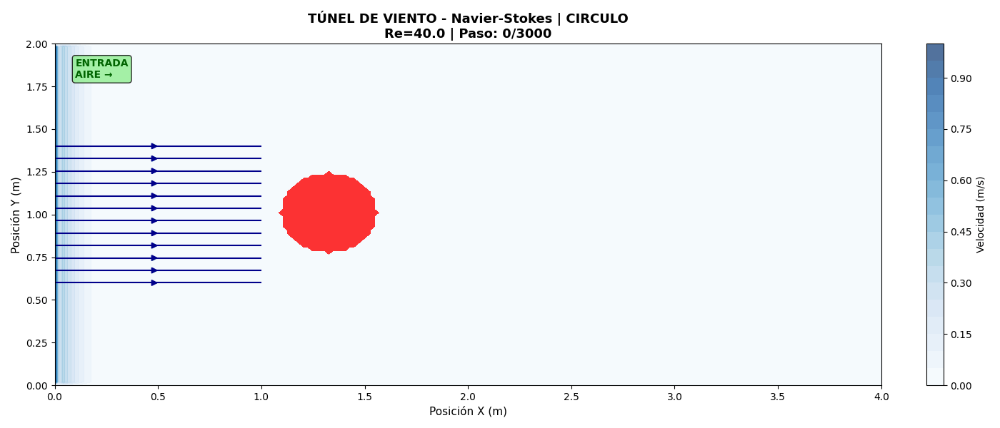

In [33]:
from IPython.display import Image
Image(open('./outputs/tunel_NavierStokes_circulo.gif','rb').read())

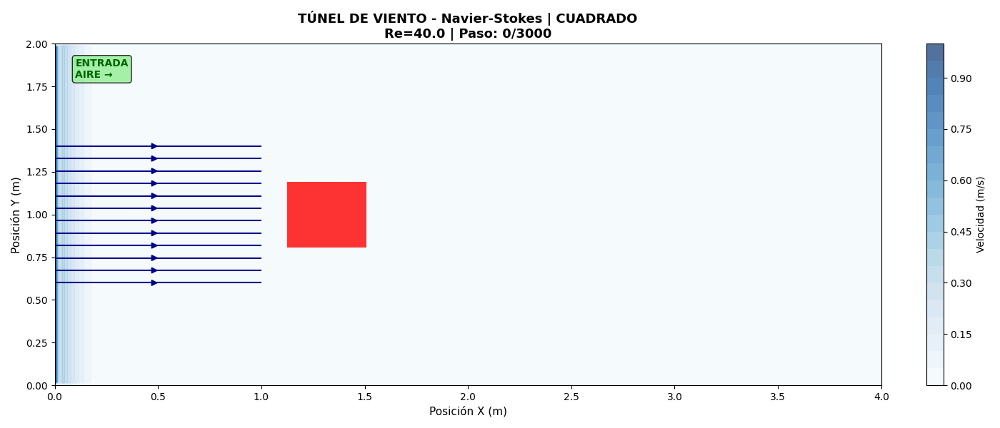

In [34]:
Image(open('./outputs/tunel_NavierStokes_cuadrado.gif','rb').read())

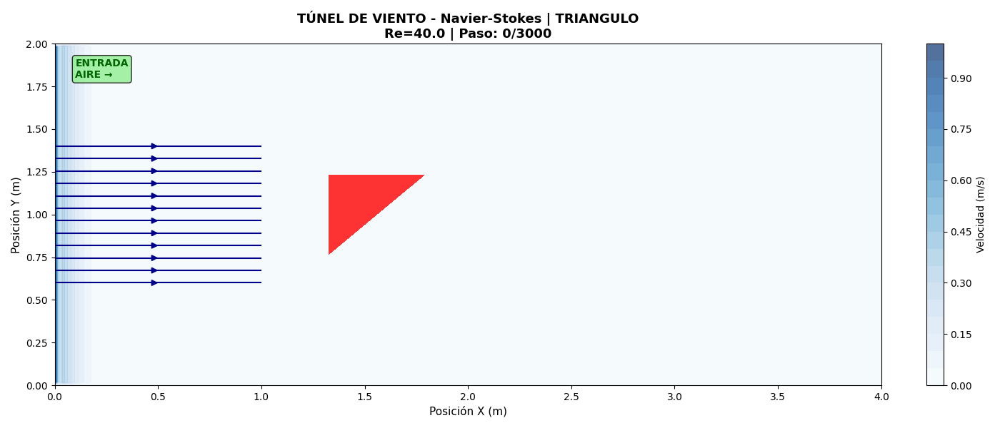

In [35]:
Image(open('./outputs/tunel_NavierStokes_triangulo.gif','rb').read())